**Combining both Application data and Previous data files for Analysis**

In [1]:
#importing required libraries and warnings
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings(action='ignore')

In [3]:

previous_data = pd.read_csv('previous_application.csv')

#https://drive.google.com/drive/folders/16RQztUqCfJOlbooHqYlJrp6Q7iL65uZB

In [5]:
application_data = pd.read_csv('application_data.csv')

#https://drive.google.com/drive/folders/16RQztUqCfJOlbooHqYlJrp6Q7iL65uZB

In [7]:
df_merged = pd.merge(previous_data,application_data, on='SK_ID_CURR', how='inner')
df_merged.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE_x,AMT_ANNUITY_x,AMT_APPLICATION,AMT_CREDIT_x,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE_x,WEEKDAY_APPR_PROCESS_START_x,HOUR_APPR_PROCESS_START_x,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,0,0,0,0,0.0,0.0,0.0,1.0,2.0,8.0


In [5]:
df_merged.shape

(1670214, 158)

In [9]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1413701 entries, 0 to 1413700
Columns: 158 entries, SK_ID_PREV to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(80), int64(46), object(32)
memory usage: 1.7+ GB


** Dropping Columns with null values more than 20%**

In [11]:
100*df_merged.isnull().mean()

SK_ID_PREV                     0.000000
SK_ID_CURR                     0.000000
NAME_CONTRACT_TYPE_x           0.000000
AMT_ANNUITY_x                 21.731469
AMT_APPLICATION                0.000000
                                ...    
AMT_REQ_CREDIT_BUREAU_DAY     11.574371
AMT_REQ_CREDIT_BUREAU_WEEK    11.574371
AMT_REQ_CREDIT_BUREAU_MON     11.574371
AMT_REQ_CREDIT_BUREAU_QRT     11.574371
AMT_REQ_CREDIT_BUREAU_YEAR    11.574371
Length: 158, dtype: float64

In [13]:
cut_off=20
cols_to_drop=list(df_merged.columns[100*df_merged.isnull().mean()>cut_off])
print(cols_to_drop,len(cols_to_drop))

['AMT_ANNUITY_x', 'AMT_DOWN_PAYMENT', 'AMT_GOODS_PRICE_x', 'RATE_DOWN_PAYMENT', 'RATE_INTEREST_PRIMARY', 'RATE_INTEREST_PRIVILEGED', 'NAME_TYPE_SUITE_x', 'CNT_PAYMENT', 'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE', 'DAYS_LAST_DUE_1ST_VERSION', 'DAYS_LAST_DUE', 'DAYS_TERMINATION', 'NFLAG_INSURED_ON_APPROVAL', 'OWN_CAR_AGE', 'OCCUPATION_TYPE', 'EXT_SOURCE_1', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE', 'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI', 

In [15]:
df_merged=df_merged.drop(cols_to_drop,axis=1)

In [11]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 87 columns):
 #   Column                        Non-Null Count    Dtype  
---  ------                        --------------    -----  
 0   SK_ID_PREV                    1670214 non-null  int64  
 1   SK_ID_CURR                    1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE_x          1670214 non-null  object 
 3   AMT_APPLICATION               1670214 non-null  float64
 4   AMT_CREDIT_x                  1670213 non-null  float64
 5   WEEKDAY_APPR_PROCESS_START_x  1670214 non-null  object 
 6   HOUR_APPR_PROCESS_START_x     1670214 non-null  int64  
 7   FLAG_LAST_APPL_PER_CONTRACT   1670214 non-null  object 
 8   NFLAG_LAST_APPL_IN_DAY        1670214 non-null  int64  
 9   NAME_CASH_LOAN_PURPOSE        1670214 non-null  object 
 10  NAME_CONTRACT_STATUS          1670214 non-null  object 
 11  DAYS_DECISION                 1670214 non-null  int64  
 12  NAME_PAYMENT_TYPE           

**
Removing Columns that are irrelavant for analysi**s

In [17]:
cols_irrelevant = ['DAYS_REGISTRATION','FLAG_MOBIL','FLAG_EMP_PHONE','FLAG_WORK_PHONE','FLAG_CONT_MOBILE',
                   'FLAG_PHONE','FLAG_EMAIL','CNT_FAM_MEMBERS','REGION_RATING_CLIENT_W_CITY','REGION_RATING_CLIENT','LIVE_REGION_NOT_WORK_REGION',
                   'REG_CITY_NOT_LIVE_CITY','REG_CITY_NOT_WORK_CITY','LIVE_CITY_NOT_WORK_CITY','DAYS_LAST_PHONE_CHANGE','EXT_SOURCE_2',
                  'OBS_30_CNT_SOCIAL_CIRCLE','DEF_30_CNT_SOCIAL_CIRCLE','OBS_60_CNT_SOCIAL_CIRCLE','DEF_60_CNT_SOCIAL_CIRCLE','DAYS_LAST_PHONE_CHANGE',
                  'REG_REGION_NOT_LIVE_REGION','REG_REGION_NOT_WORK_REGION','WEEKDAY_APPR_PROCESS_START_y',
                  'DAYS_ID_PUBLISH','REGION_POPULATION_RELATIVE','FLAG_OWN_REALTY','FLAG_OWN_CAR','NAME_SELLER_INDUSTRY','SELLERPLACE_AREA','CHANNEL_TYPE',
                  'NAME_PRODUCT_TYPE','NAME_PORTFOLIO','NAME_GOODS_CATEGORY','DAYS_DECISION','NAME_CASH_LOAN_PURPOSE','NFLAG_LAST_APPL_IN_DAY','FLAG_LAST_APPL_PER_CONTRACT',
                 'HOUR_APPR_PROCESS_START_x','WEEKDAY_APPR_PROCESS_START_x','CNT_CHILDREN','HOUR_APPR_PROCESS_START_y']

len(cols_irrelevant)


42

In [19]:
df_merged=df_merged.drop(cols_irrelevant,axis=1)

In [21]:
df_merged=df_merged.drop(df_merged.loc[:,'FLAG_DOCUMENT_2': ],axis=1)

In [23]:
df_merged.shape

(1413701, 27)

**Creating new columns Age and Work Experience from columns Days_Birth and Days_Employed**

In [ ]:
df_merged['AGE'] = abs(df_merged['DAYS_BIRTH']//365)

In [27]:
df_merged['Work_Experience'] = abs(df_merged['DAYS_EMPLOYED']//365)

In [29]:
df_merged = df_merged.drop(['DAYS_BIRTH','DAYS_EMPLOYED'],axis=1)

In [39]:
df_merged=df_merged[~(df_merged['CODE_REJECT_REASON']=='XAP')]

In [41]:
df_merged=df_merged[~(df_merged['NAME_CONTRACT_TYPE_x']=='XNA')]

In [43]:
df_merged=df_merged[~(df_merged['NAME_PAYMENT_TYPE']=='XNA')]

In [45]:
df_merged=df_merged[~(df_merged['NAME_CLIENT_TYPE']=='XNA')]

In [47]:
df_merged=df_merged[~(df_merged['NAME_YIELD_GROUP']=='XNA')]

In [49]:
df_merged.shape

(150502, 27)

**Dividing into Numerical and Categorical colummns**

In [52]:
mer_cat_cols=list(df_merged.dtypes[df_merged.dtypes=='object'].index)

In [54]:
mer_num_cols=list(df_merged.dtypes[df_merged.dtypes!='object'].index)

**Replacing Null values of categorical columns with mode**

In [57]:
for col in mer_cat_cols:
    mod=df_merged[col].mode()[0] 
    df_merged[col]=df_merged[col].fillna(mod)

In [59]:
100*df_merged[mer_cat_cols].isnull().mean()

NAME_CONTRACT_TYPE_x    0.0
NAME_CONTRACT_STATUS    0.0
NAME_PAYMENT_TYPE       0.0
CODE_REJECT_REASON      0.0
NAME_CLIENT_TYPE        0.0
NAME_YIELD_GROUP        0.0
PRODUCT_COMBINATION     0.0
NAME_CONTRACT_TYPE_y    0.0
CODE_GENDER             0.0
NAME_TYPE_SUITE_y       0.0
NAME_INCOME_TYPE        0.0
NAME_EDUCATION_TYPE     0.0
NAME_FAMILY_STATUS      0.0
NAME_HOUSING_TYPE       0.0
ORGANIZATION_TYPE       0.0
dtype: float64

**Replacing null values of Numerical columns with Median**

In [61]:
for col in mer_num_cols:
    med=df_merged[col].median()
    df_merged[col]=df_merged[col].fillna(med)

In [63]:
100*df_merged[mer_num_cols].isnull().mean()

SK_ID_PREV           0.0
SK_ID_CURR           0.0
AMT_APPLICATION      0.0
AMT_CREDIT_x         0.0
TARGET               0.0
AMT_INCOME_TOTAL     0.0
AMT_CREDIT_y         0.0
AMT_ANNUITY_y        0.0
AMT_GOODS_PRICE_y    0.0
EXT_SOURCE_3         0.0
AGE                  0.0
Work_Experience      0.0
dtype: float64

**Creating Income Group columns based on total income column**

In [65]:
df_merged['Income_Group']= pd.cut(df_merged.AMT_INCOME_TOTAL,[0,130000,202500,118000000],labels=['Low','Medium','High'])

In [67]:
#Refreshing Categorical and numerical columns to add new columns
mer_cat_cols=list(df_merged.dtypes[df_merged.dtypes=='object'].index)
mer_num_cols=list(df_merged.dtypes[df_merged.dtypes!='object'].index)

**UNIVARIATE ANALYSIS**

**Using Histogram for numerical columns**

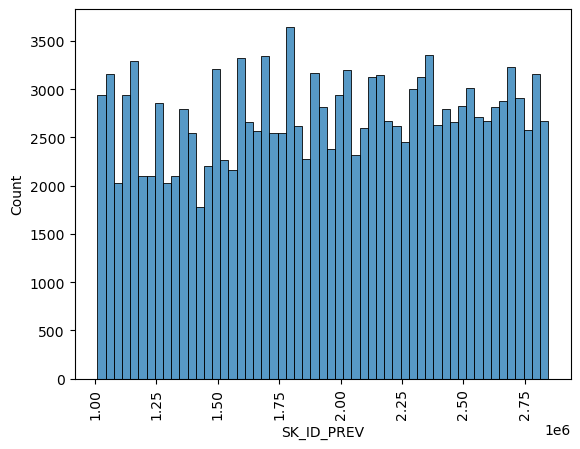

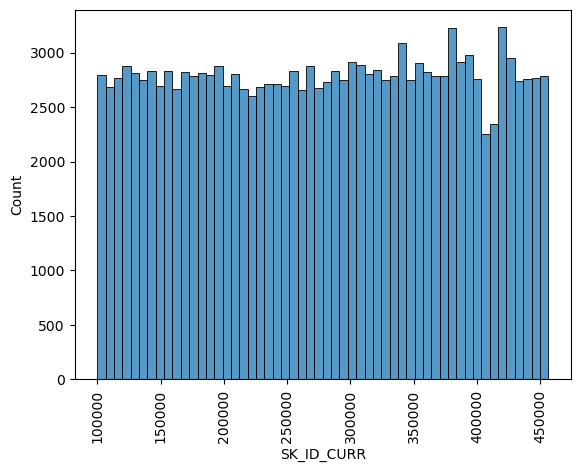

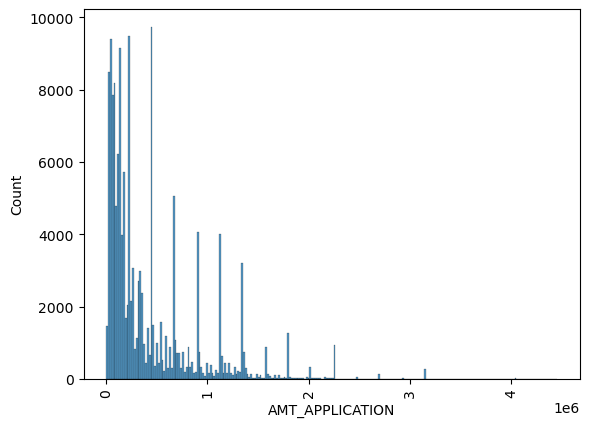

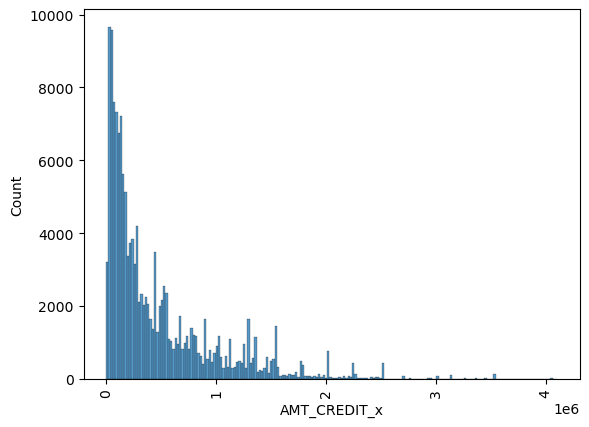

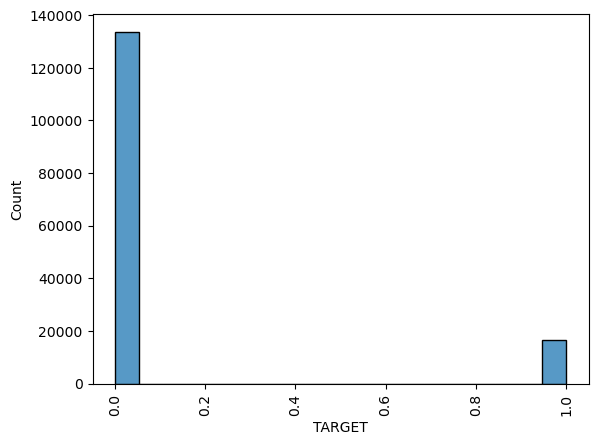

...

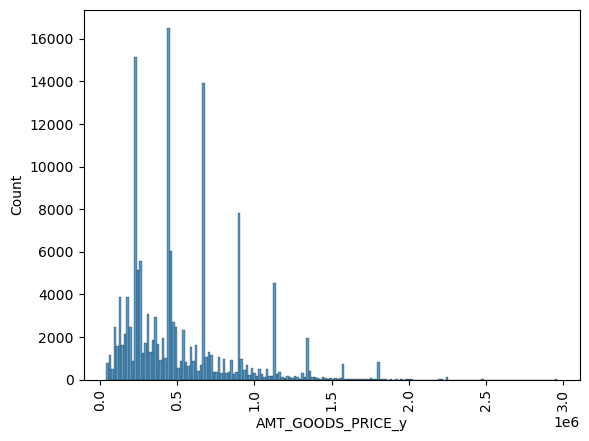

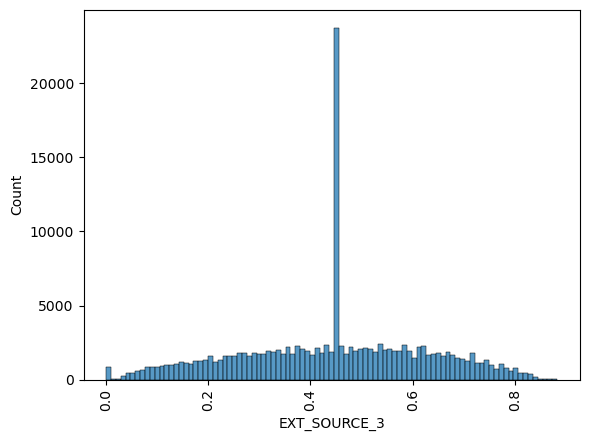

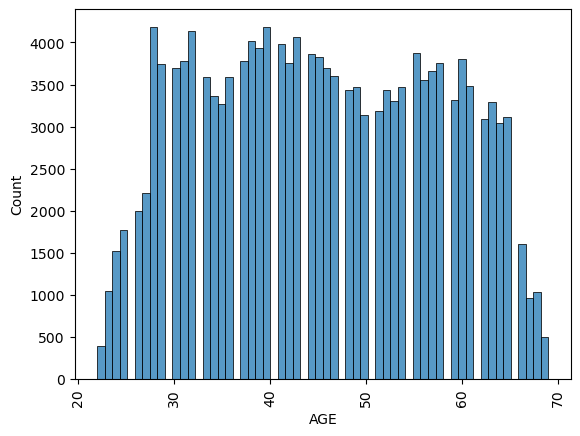

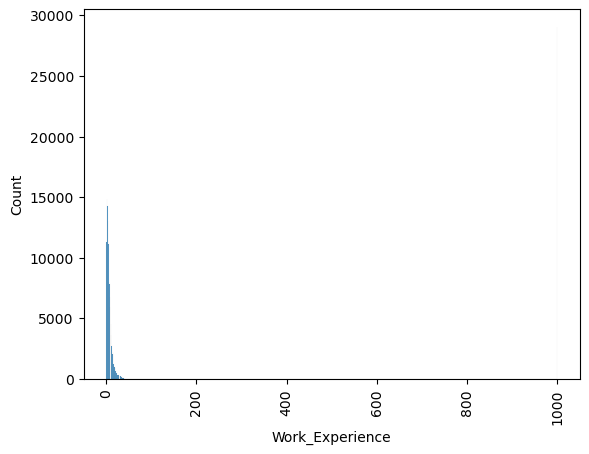

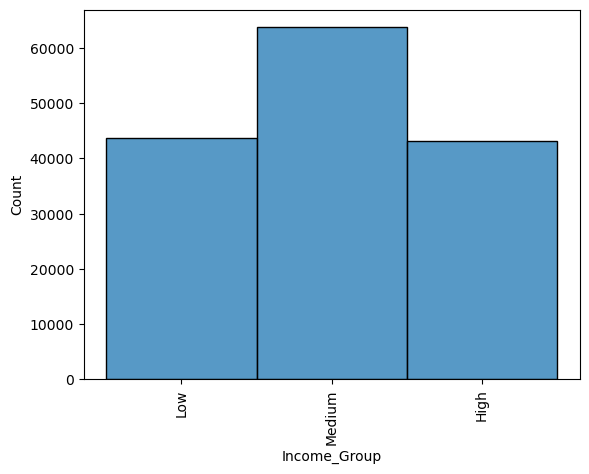

In [69]:
for col in mer_num_cols:
    sns.histplot(x=df_merged[col])
    plt.xticks(rotation=90)
    plt.show()

**Using box plot for numerical columns**

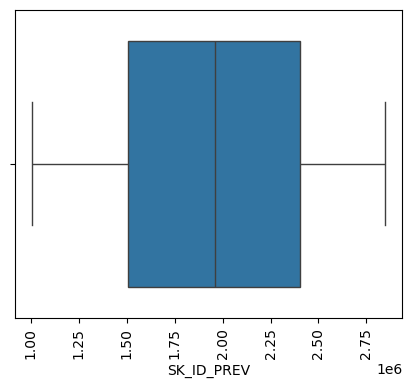

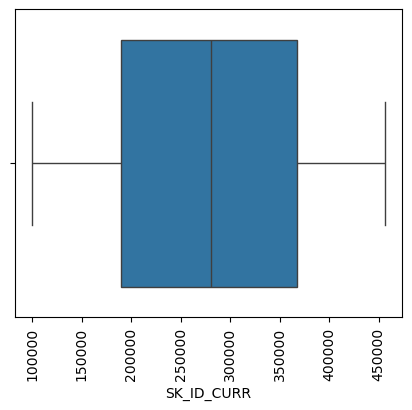

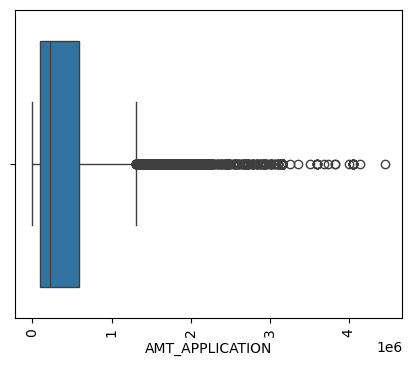

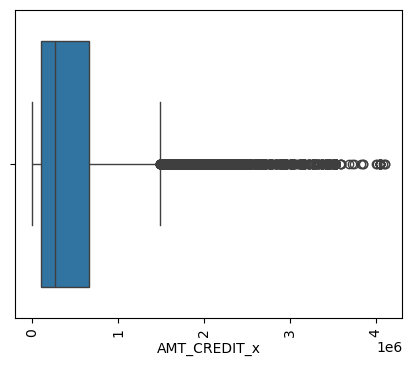

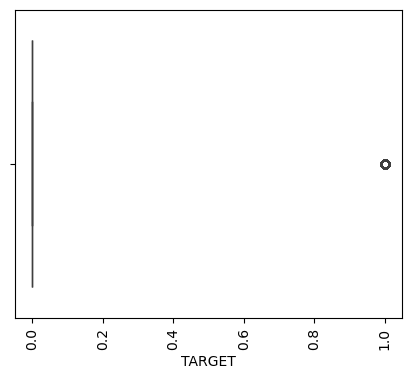

...

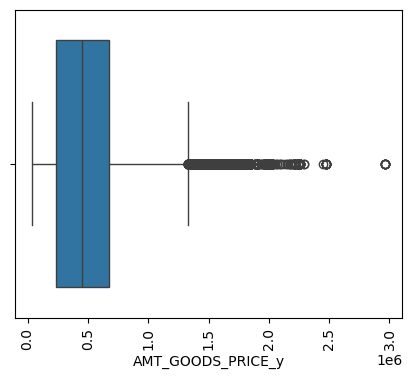

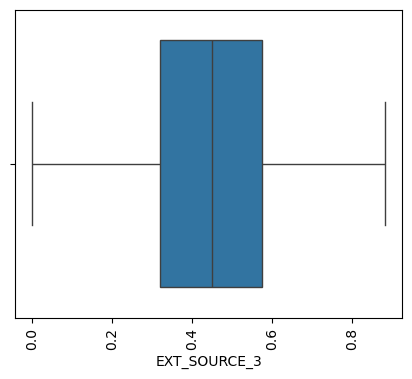

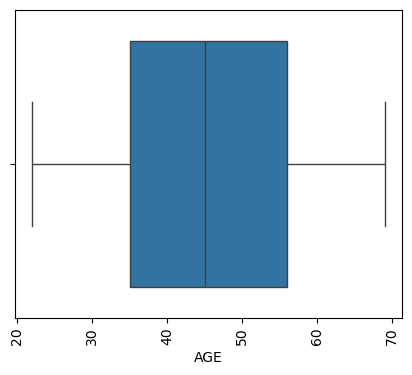

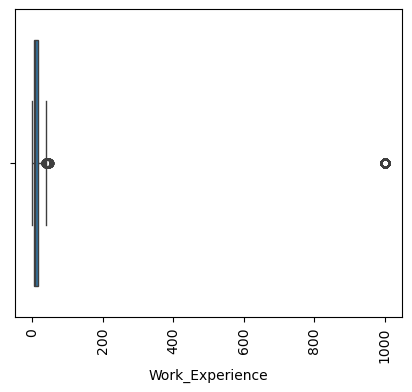

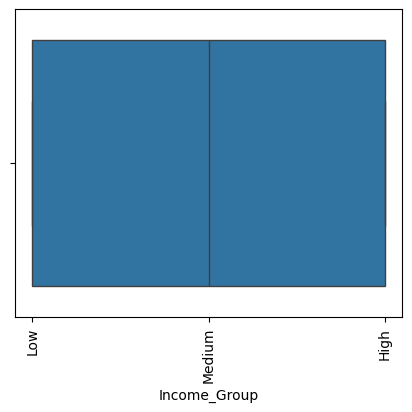

In [71]:
for col in mer_num_cols:
    plt.figure(figsize=(5,4))
    sns.boxplot(x=df_merged[col])
    plt.xticks(rotation=90)
    plt.show()

**Using count plot for categorical columns**

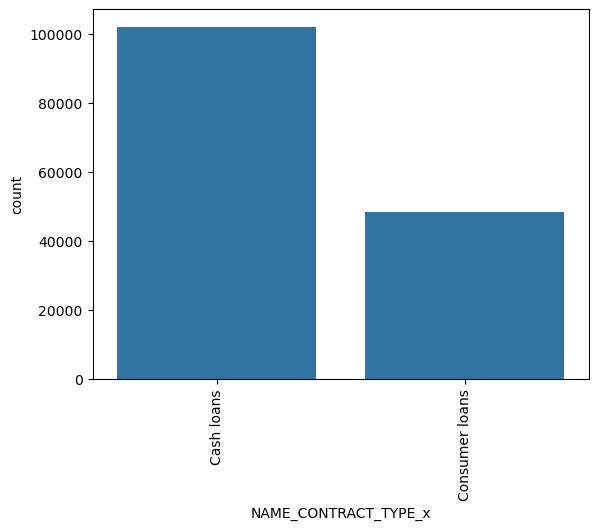

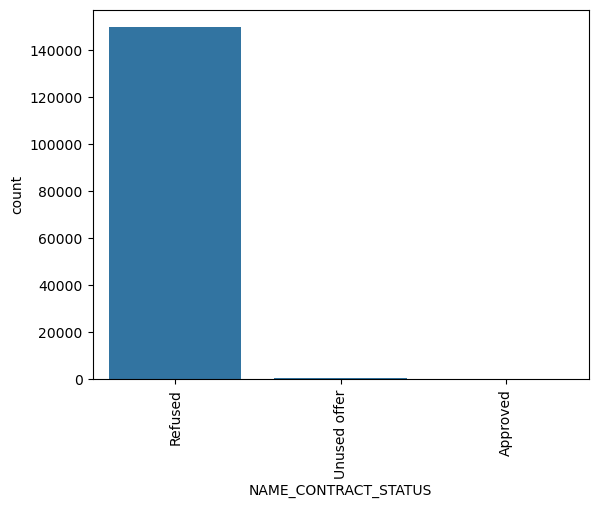

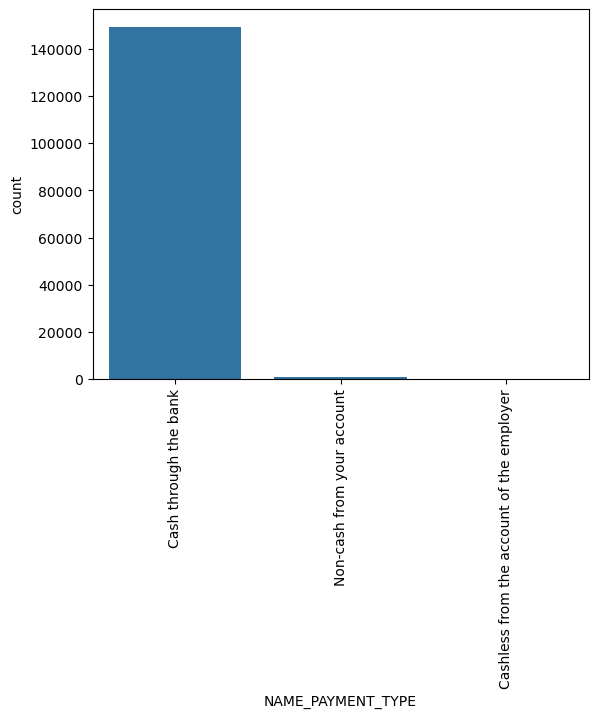

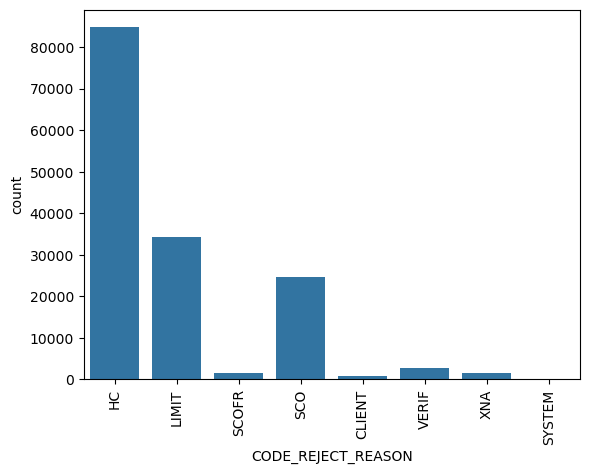

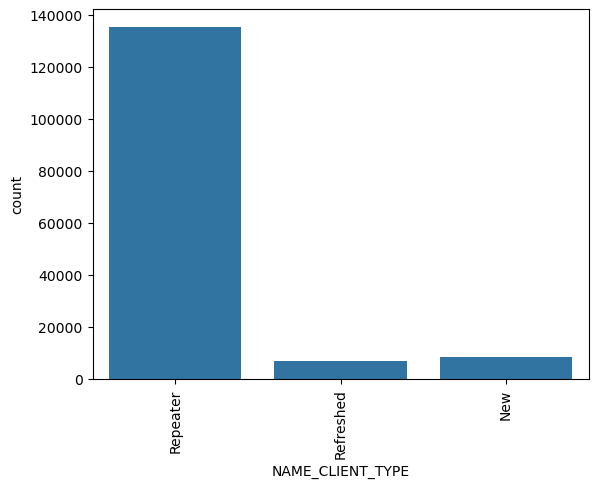

...

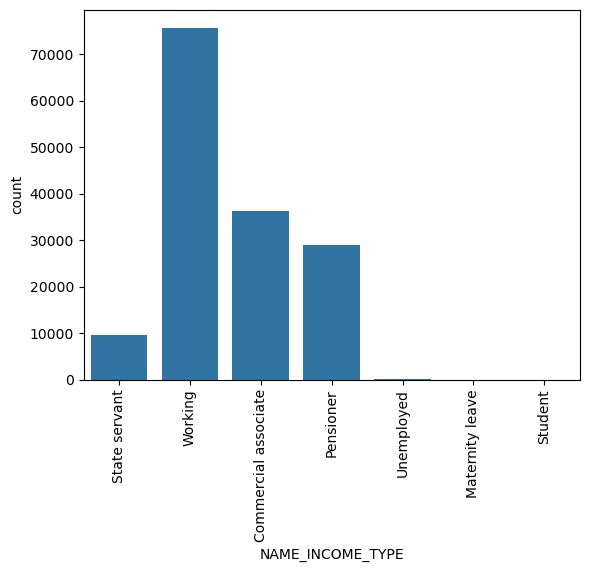

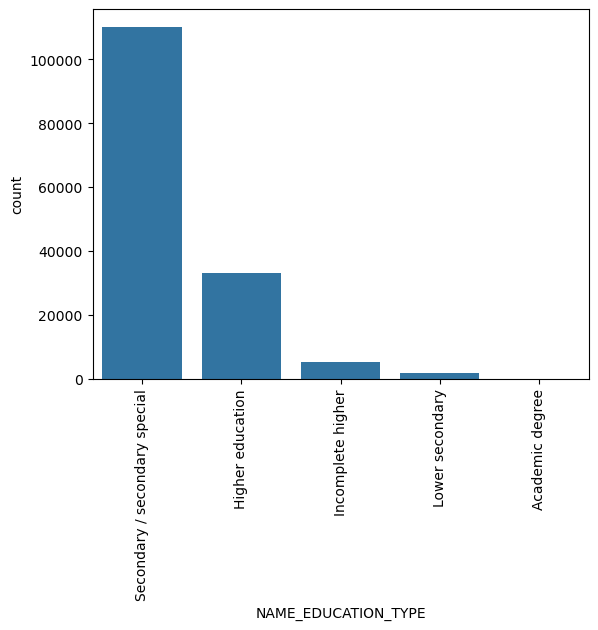

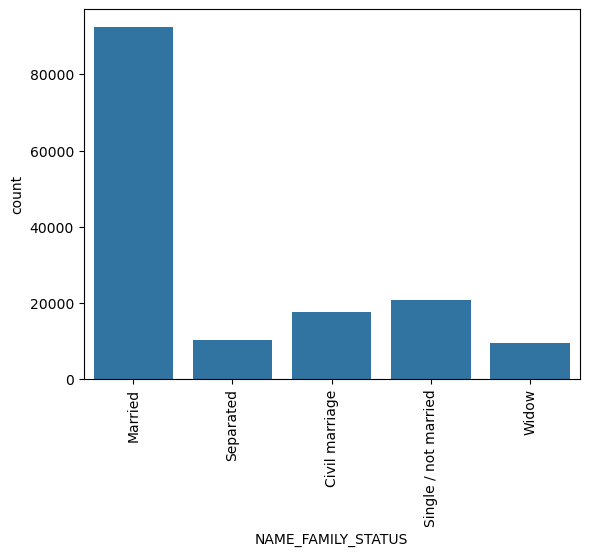

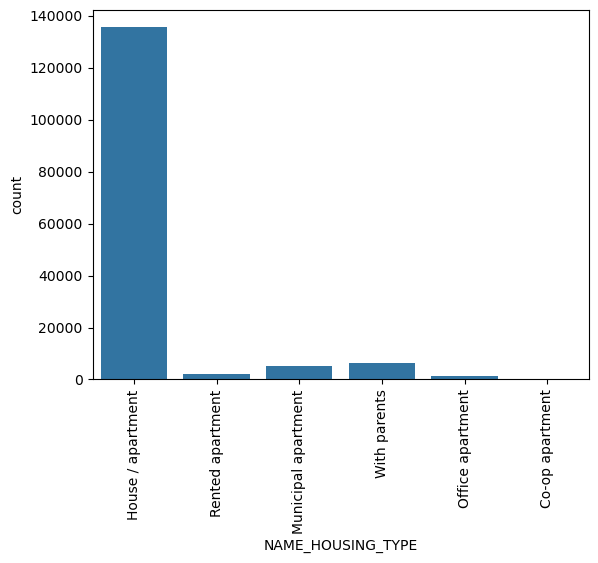

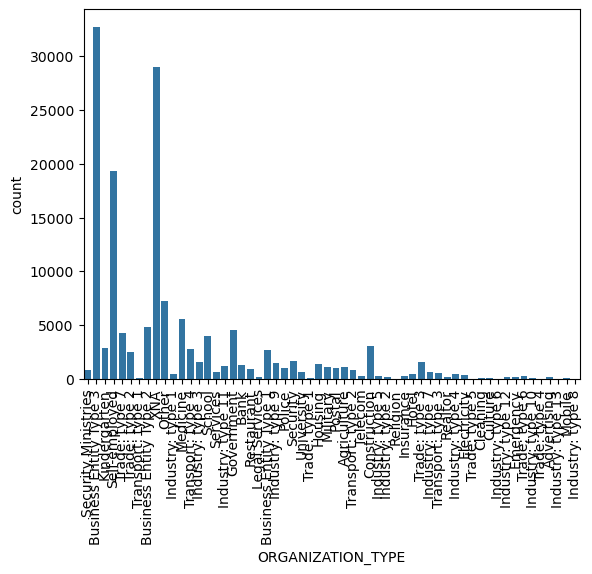

In [73]:
for col in mer_cat_cols:
    sns.countplot(x=df_merged[col])
    plt.xticks(rotation=90)
    plt.show()

**Key Takeaways from Univariate Analysis**

1.Amount Annuity and Amount Credit are less for Previous Application compared to Current Application 2.Loans are mostly from Mid aged clients, clients who are married and clients who are working 3. Females are taking more loans compared to males 4. Consumer and Cash loans were majorly taken for Previous application where as more Cash loans are taken for Current application 5.POS Mobile loans and POS House loans with Interest take precedence in type of loans opted next to Cash loans

**BIVARIATE ANALYSIS**

****SCATTER PLOT for numerical vs numerical columns****

In [75]:
#Removing irrelanat columns from list
cols_to_rem =['SK_ID_PREV','SK_ID_CURR']
mer_num_cols = [col for col in mer_num_cols if col not in cols_to_rem]
mer_num_cols

['AMT_APPLICATION',
 'AMT_CREDIT_x',
 'TARGET',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT_y',
 'AMT_ANNUITY_y',
 'AMT_GOODS_PRICE_y',
 'EXT_SOURCE_3',
 'AGE',
 'Work_Experience',
 'Income_Group']

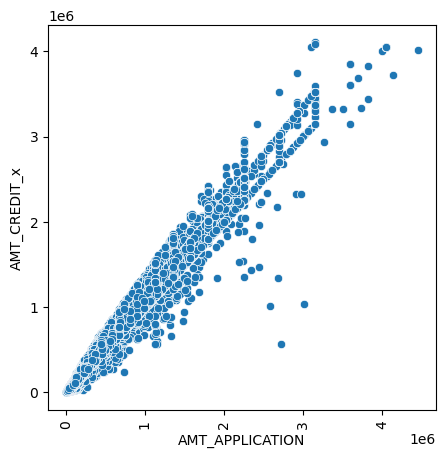

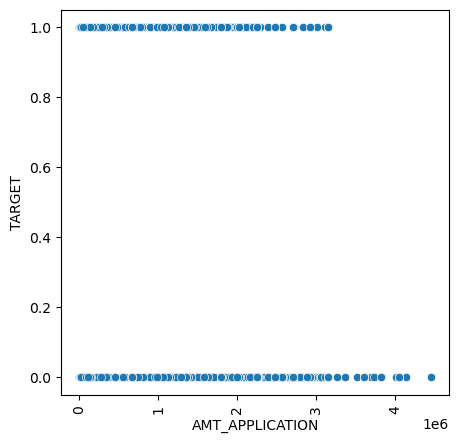

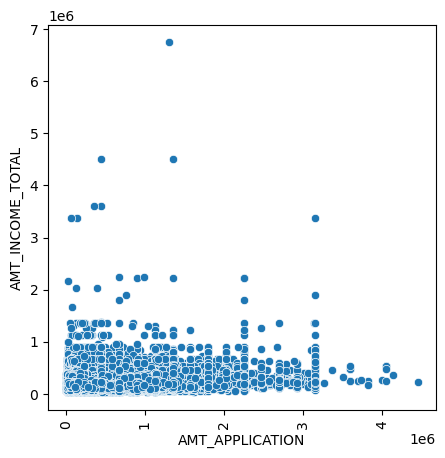

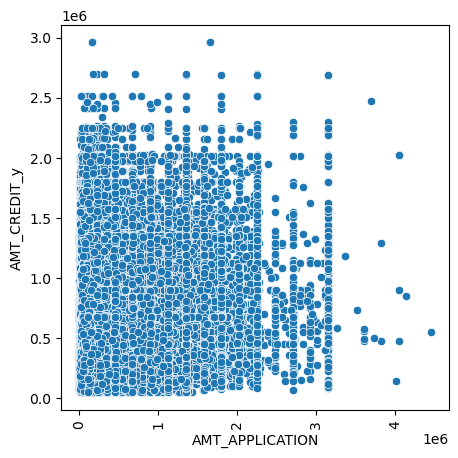

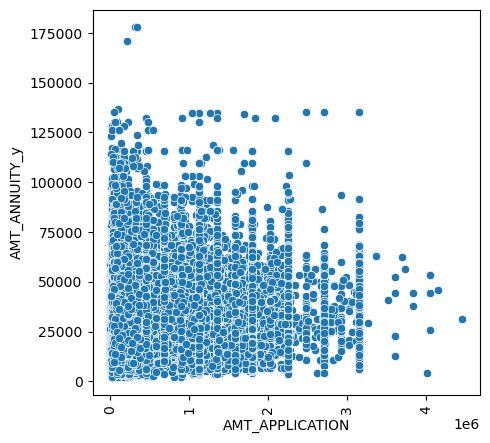

...

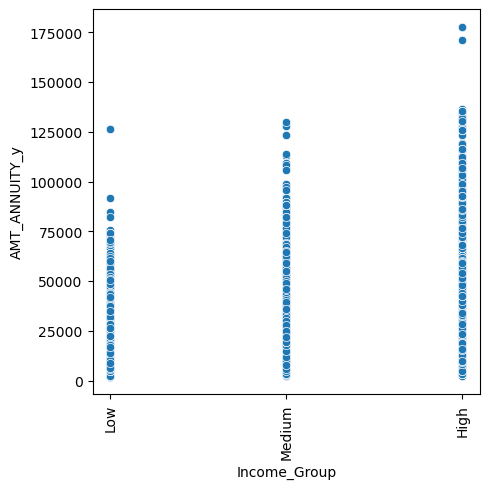

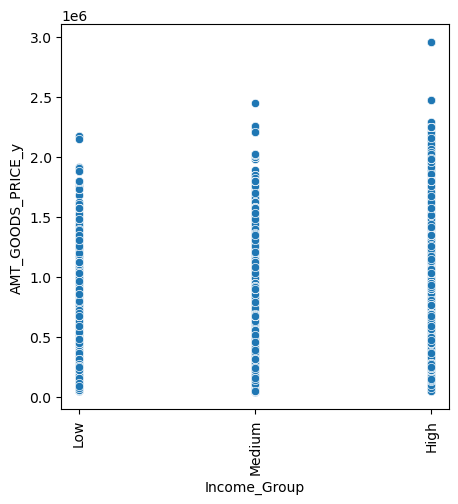

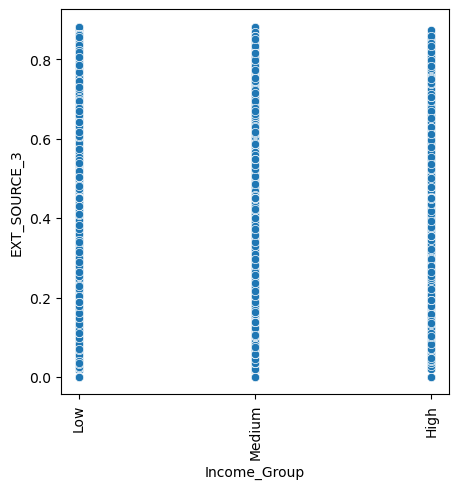

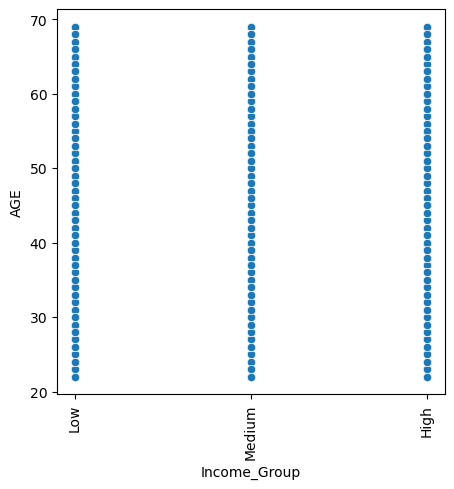

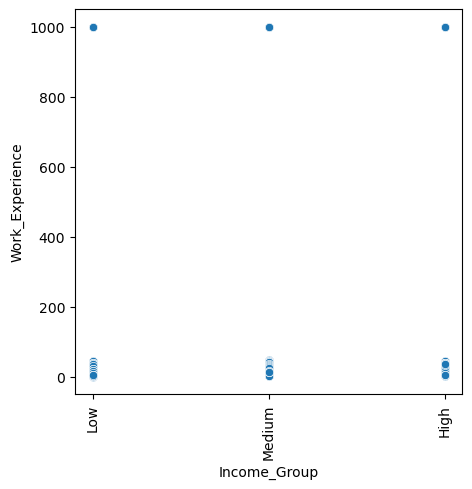

In [77]:
for col1 in mer_num_cols:
    for col2 in mer_num_cols:
        if col1!=col2:
            plt.figure(figsize=(5,5))
            sns.scatterplot(x=df_merged[col1],y=df_merged[col2])
            plt.xticks(rotation=90)
            plt.show()

**Observations**

1. Clients who had payment difficulties in Previous Application tend too have payment difficulties in current applications as well

**Box plot for Categorical vs Categorical columns**

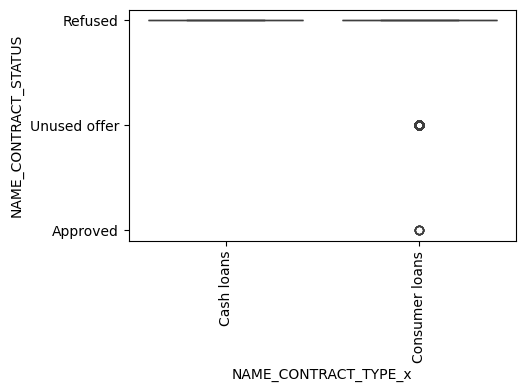

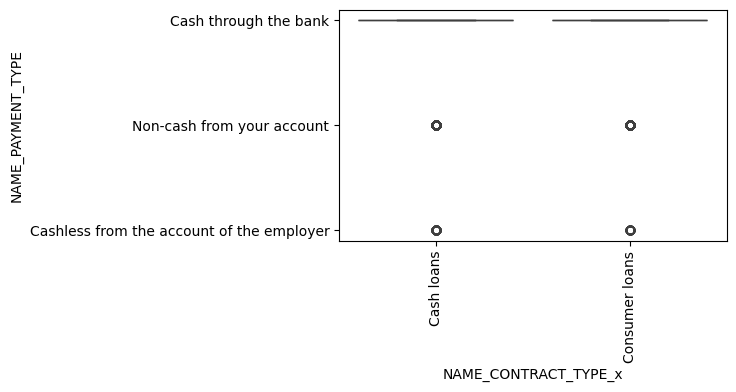

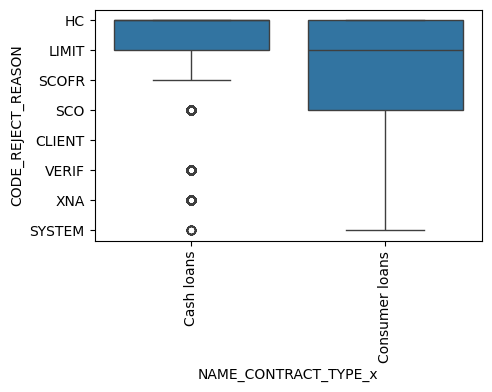

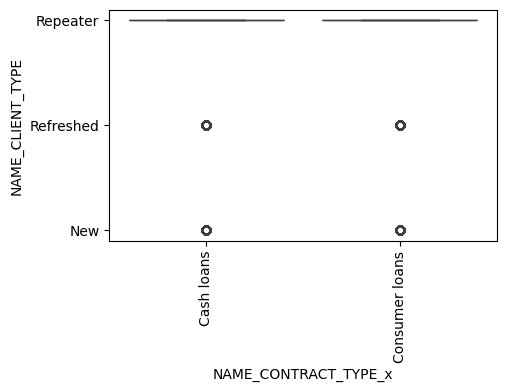

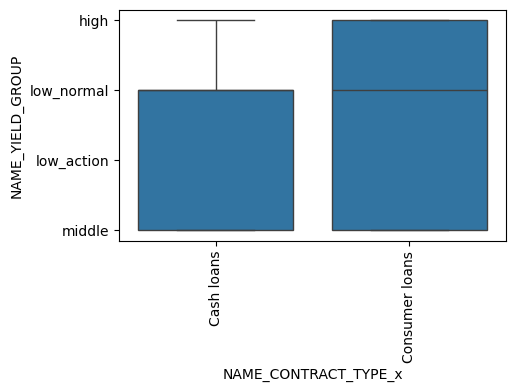

...

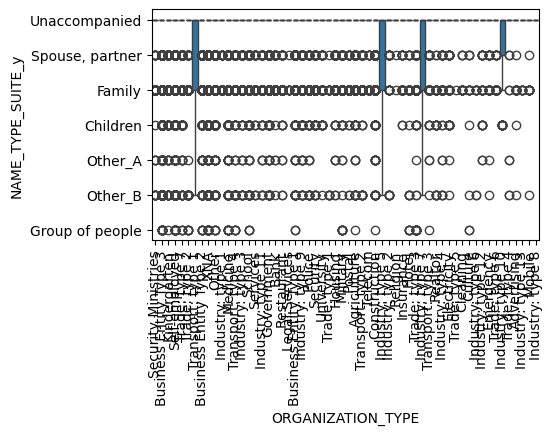

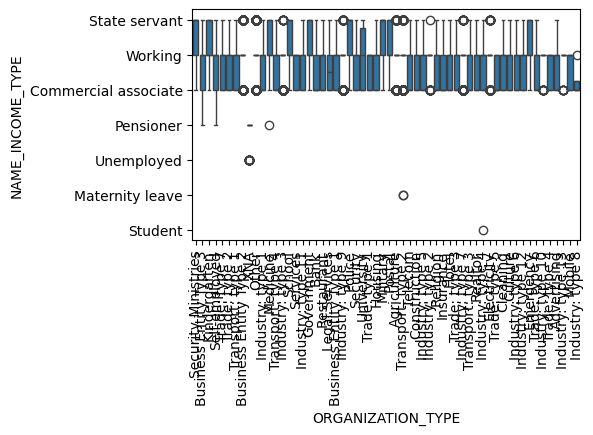

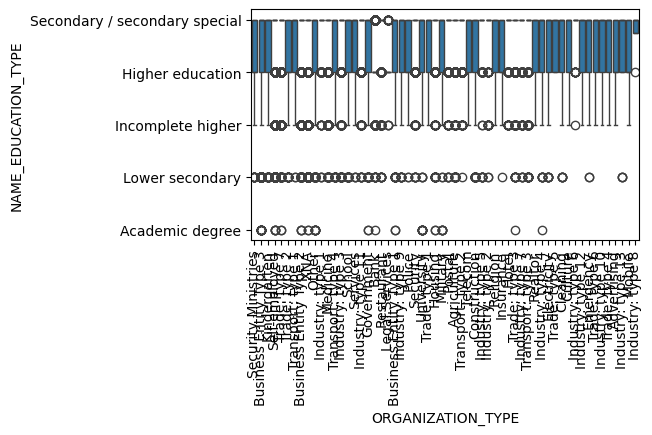

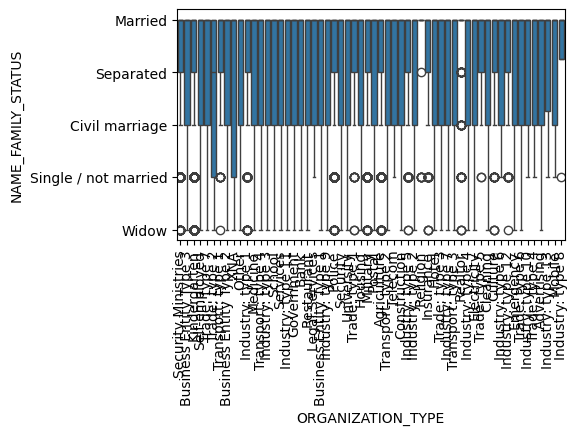

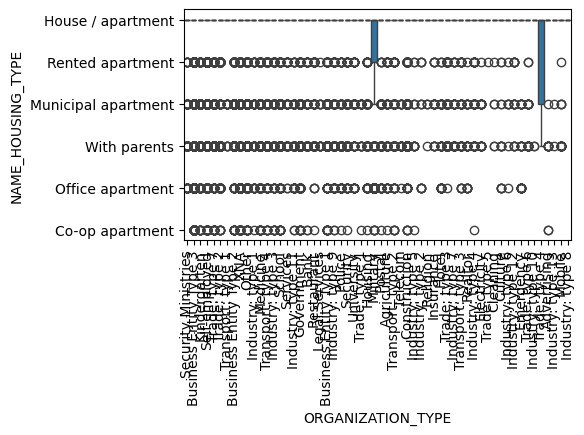

In [79]:
for col1 in mer_cat_cols:
    for col2 in mer_cat_cols:
        if col1!=col2:
            plt.figure(figsize=(5,3))
            sns.boxplot(x=df_merged[col1],y=df_merged[col2])
            plt.xticks(rotation=90)
            plt.show()

**Observations**

1.Cash loans are refused and Cash loans are refused due to High Credit and limit reasons mostly
2.Most of the Repeter and Refreshed Client types got their loans Approved in Previous applications
3.All the Approved Loans are in Low to Medium Interest range where as loans are Rejected for High Inerest rate.
4.All the Approved loans are of Married category and of clients who has House/Apartment. All the other Categories of Family Status including married  have seen Refusal of loans .


**Box plot for Numerical vs Categorical columns**

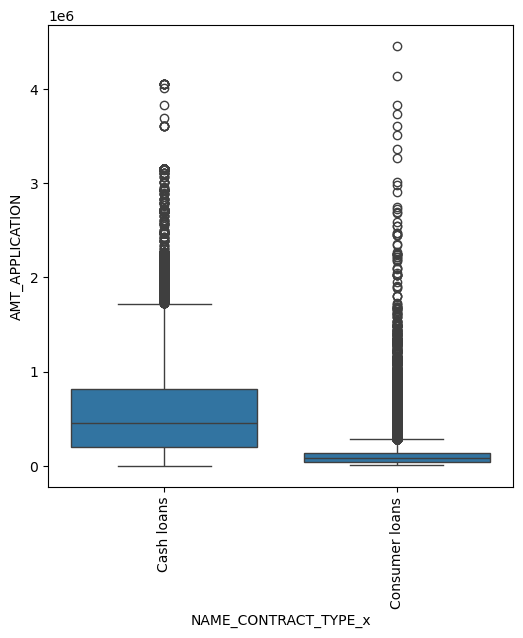

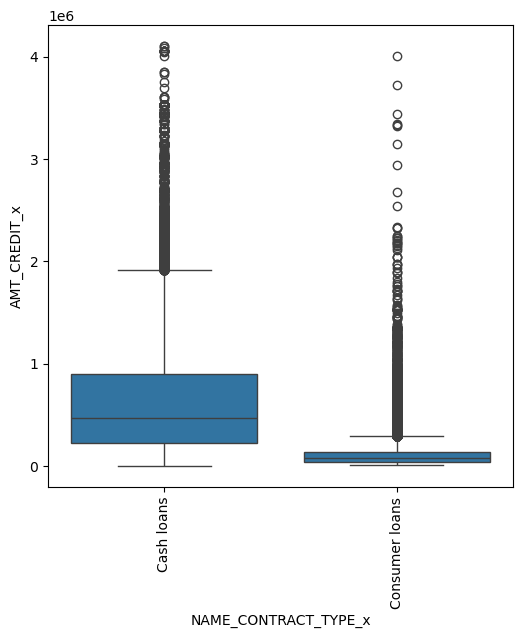

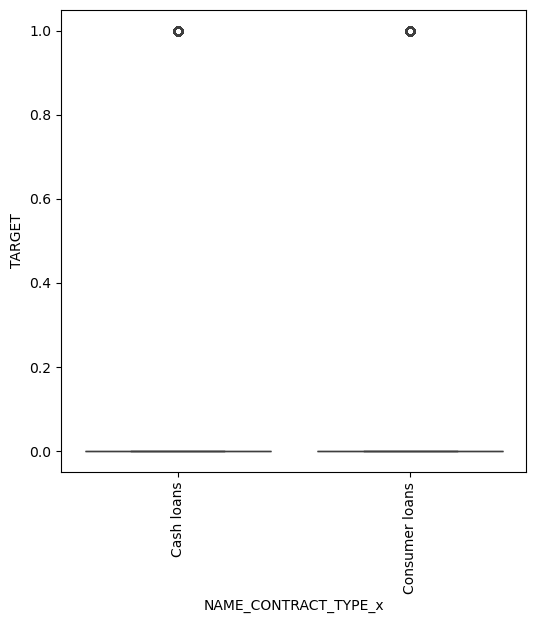

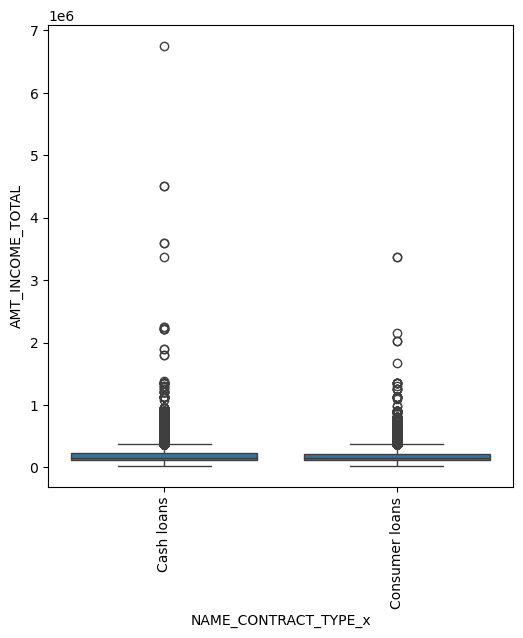

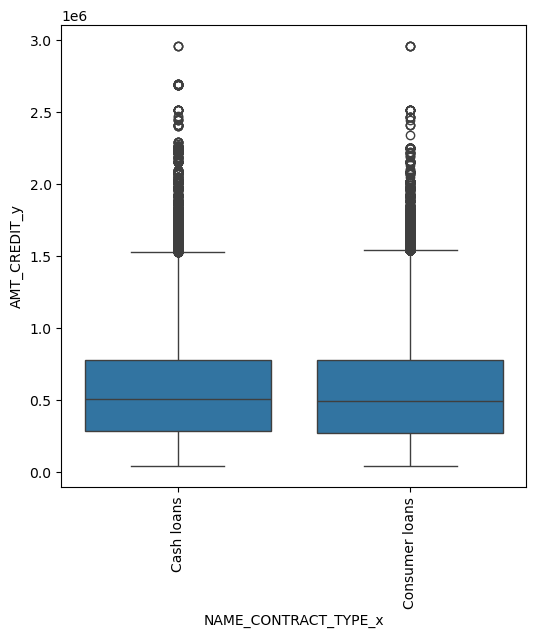

...

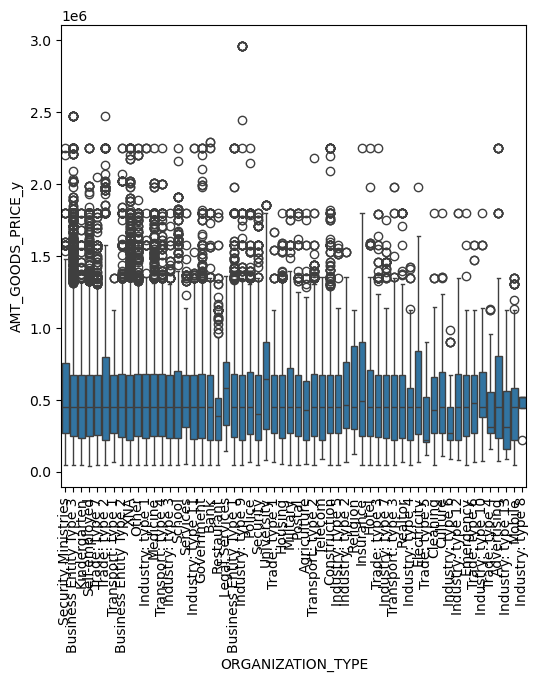

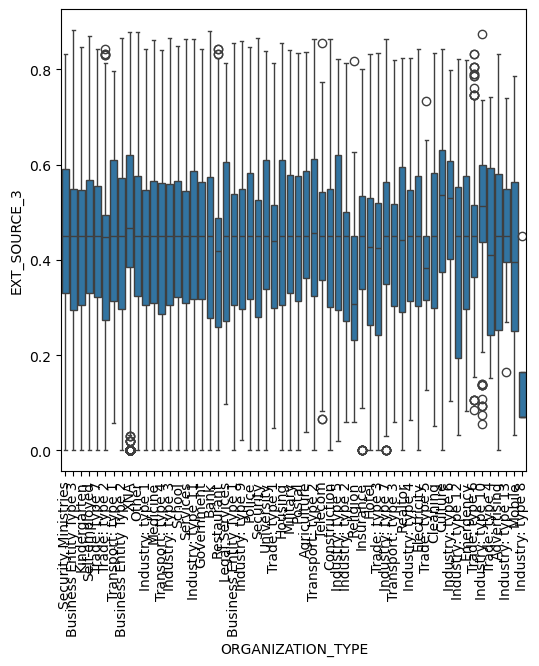

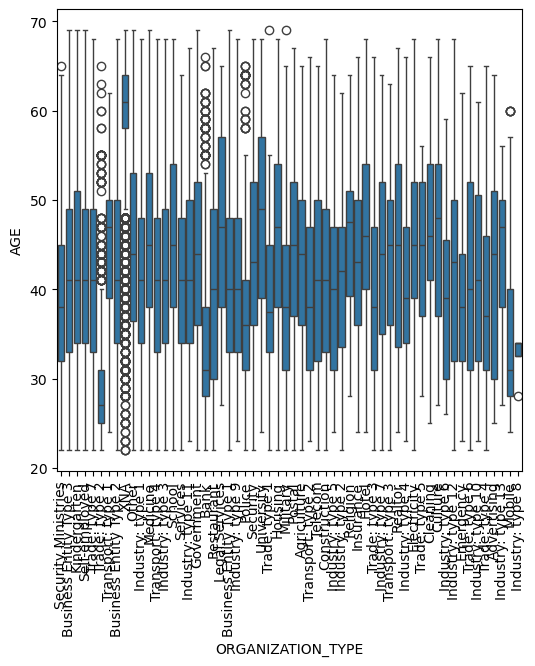

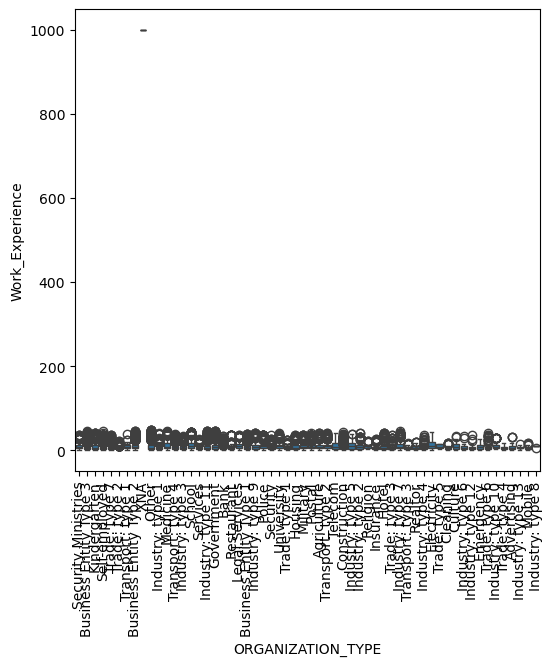

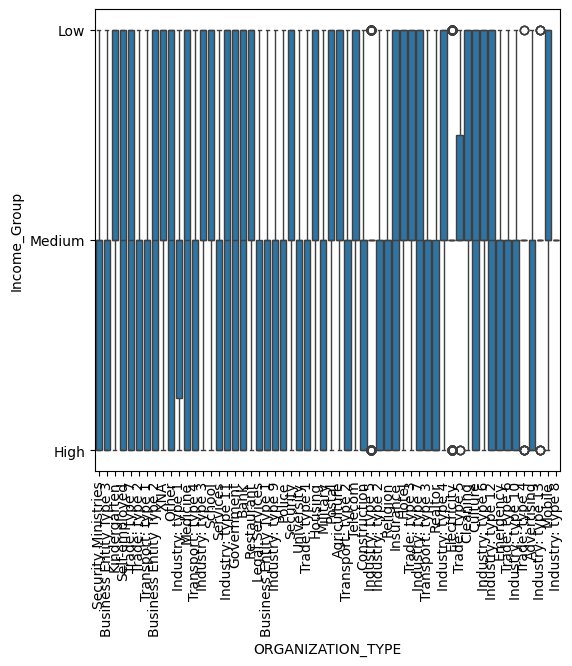

In [81]:
for col1 in mer_cat_cols:
    for col2 in mer_num_cols:
            plt.figure(figsize=(6,6))
            sns.boxplot(x=df_merged[col1],y=df_merged[col2])
            plt.xticks(rotation=90)
            plt.show()

**Observation**
1. Loans which are Rejected have high application amount
2. Some of the Loans which are Rejected are having very high income amount which concludes they either they failed the verification or submited invalid documents
3. Most of the low-Medium range Income group loans have been Accepted.

**MULTIVARIATE ANALYSIS**

In [88]:
mer_num_cols = [col for col in mer_num_cols if col != 'Income_Group']
df_corr = df_merged[mer_num_cols]
df_corr.head()

,AMT_APPLICATION,AMT_CREDIT_x,TARGET,AMT_INCOME_TOTAL,AMT_CREDIT_y,AMT_ANNUITY_y,AMT_GOODS_PRICE_y,EXT_SOURCE_3,AGE,Work_Experience
4,337500.0,404055.0,0,180000.0,628069.5,34200.0,499500.0,0.363945,28,7
17,450000.0,491580.0,0,225000.0,173092.5,16006.5,157500.0,0.450747,40,5
20,1129500.0,1277104.5,0,157500.0,1205896.5,35388.0,1053000.0,0.526295,61,2
31,32490.0,38380.5,0,117000.0,180000.0,9000.0,180000.0,0.432962,23,3
44,45000.0,47970.0,1,81000.0,112068.0,7488.0,99000.0,0.483050,27,2


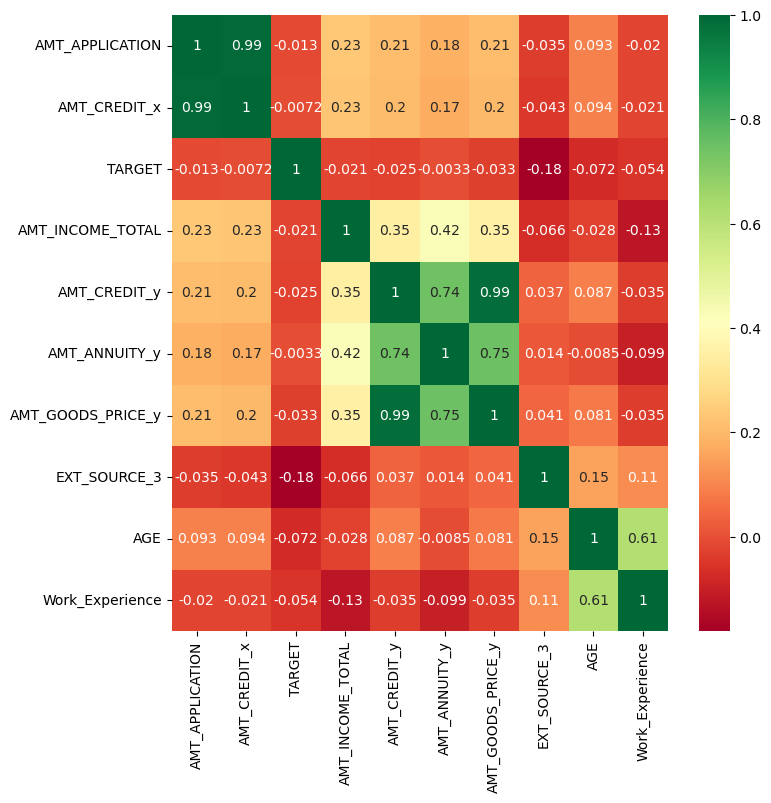

In [90]:
plt.figure(figsize=(8,8))
sns.heatmap(df_corr.corr(),annot=True,cmap='RdYlGn')
plt.show()

**Observation**
1.Application amount and amount credit have Highest correlation 
2.Age and work experience have good correlation 
3.Annuity amount and Credit amount have good correlation 
4. External source info and Target have highest Negative Correlation
5.Work Experience and Total income have negative correlation